In [ ]:
%%time 

# Important library for many geopython libraries
!apt install gdal-bin python-gdal python3-gdal 
# Install rtree - Geopandas requirment
!apt install python3-rtree 
# Install Geopandas
!pip install git+git://github.com/geopandas/geopandas.git
# Install descartes - Geopandas requirment
!pip install descartes 
# Install Folium for Geographic data visualization
!pip install folium
# Install plotlyExpress
!pip install plotly_express

Reading package lists... Done
Building dependency tree       
Reading state information... Done
gdal-bin is already the newest version (2.2.3+dfsg-2).
python-gdal is already the newest version (2.2.3+dfsg-2).
python3-gdal is already the newest version (2.2.3+dfsg-2).
0 upgraded, 0 newly installed, 0 to remove and 13 not upgraded.
Reading package lists... Done
Building dependency tree       
Reading state information... Done
python3-rtree is already the newest version (0.8.3+ds-1).
0 upgraded, 0 newly installed, 0 to remove and 13 not upgraded.
  Cloning git://github.com/geopandas/geopandas.git to /tmp/pip-req-build-vxim60to
  Running command git clone -q git://github.com/geopandas/geopandas.git /tmp/pip-req-build-vxim60to
  Created wheel for geopandas: filename=geopandas-0.8.0+85.geabe404-py2.py3-none-any.whl size=976150 sha256=13941fa04984cc5670e6b9a0f5ff8f81e0a7d633826c5875c7d35027a355aad5
  Stored in directory: /tmp/pip-ephem-wheel-cache-ephmr1l1/wheels/91/24/71/376c9c67192694168352

In [ ]:
import pandas as pd
import numpy as np
import geopandas as gpd
from shapely.geometry import Point
import matplotlib
import matplotlib.pyplot as plt 
import folium
import plotly_express as px

In [ ]:
districtcode = pd.read_excel('districtcode.xls')

In [ ]:
districtcode

,Code,District
0,1,Kupwara
1,3,Leh
2,4,Kargil
3,5,Punch
4,6,Rajouri
...,...,...
599,636,Mahe
600,637,Karaikal
601,638,Nicobars
602,639,North and Middle Andaman


In [ ]:
map_state = "final/2011_Dist.shp"
map_df = gpd.read_file(map_state)
map_df.columns

Index(['DISTRICT', 'ST_NM', 'ST_CEN_CD', 'DT_CEN_CD', 'censuscode',
       'geometry'],
      dtype='object')

In [ ]:
map_df = map_df.drop(['DISTRICT', 'ST_NM', 'ST_CEN_CD', 'DT_CEN_CD'], axis = 1)

In [ ]:
districtwise = pd.read_csv('district_wise.csv')
districtwise.columns

Index(['SlNo', 'State_Code', 'State', 'District_Key', 'District_code',
       'District', 'Confirmed', 'Active', 'Recovered', 'Deceased',
       'Migrated_Other', 'Delta_Confirmed', 'Delta_Active', 'Delta_Recovered',
       'Delta_Deceased', 'District_Notes', 'Last_Updated'],
      dtype='object')

In [ ]:
map_df

,censuscode,geometry
0,532,"POLYGON ((78.84972 19.76010, 78.85102 19.75945..."
1,146,"POLYGON ((78.19803 27.40280, 78.19804 27.40278..."
2,474,"MULTIPOLYGON (((72.03456 23.50527, 72.03337 23..."
3,522,"POLYGON ((74.67333 19.94670, 74.67393 19.93509..."
4,283,"POLYGON ((92.98749 24.40453, 92.99107 24.40236..."
...,...,...
636,493,"POLYGON ((74.08573 21.55513, 74.08672 21.55515..."
637,638,"MULTIPOLYGON (((93.84861 7.24051, 93.84870 7.2..."
638,640,"MULTIPOLYGON (((92.69758 12.23961, 92.69778 12..."
639,639,"MULTIPOLYGON (((92.89905 12.91512, 92.89905 12..."


In [ ]:
merged = pd.read_csv('merged.csv')

In [ ]:
merged


,Unnamed: 0,Code,District,Confirmed,Active,Recovered,Deceased
0,0,1,Kupwara,5631,58,5479,94
1,1,3,Leh,7565,73,7408,84
2,2,4,Kargil,2103,4,2055,44
3,3,5,Punch,2485,30,2431,24
4,4,6,Rajouri,3864,7,3802,55
...,...,...,...,...,...,...,...
609,609,636,Mahe,1942,71,1862,9
610,610,637,Karaikal,3849,24,3761,64
611,611,638,Nicobars,0,0,0,0
612,612,639,North and Middle Andaman,1,0,1,0


In [ ]:
merged.columns


Index(['Unnamed: 0', 'Code', 'District', 'Confirmed', 'Active', 'Recovered',
       'Deceased'],
      dtype='object')

In [ ]:
merged = merged.drop(['Unnamed: 0'], axis = 1)

In [ ]:
merged

,Code,District,Confirmed,Active,Recovered,Deceased
0,1,Kupwara,5631,58,5479,94
1,3,Leh,7565,73,7408,84
2,4,Kargil,2103,4,2055,44
3,5,Punch,2485,30,2431,24
4,6,Rajouri,3864,7,3802,55
...,...,...,...,...,...,...
609,636,Mahe,1942,71,1862,9
610,637,Karaikal,3849,24,3761,64
611,638,Nicobars,0,0,0,0
612,639,North and Middle Andaman,1,0,1,0


In [ ]:
merged_final = pd.merge(left=merged, right=map_df, left_on='Code', right_on='censuscode')

In [ ]:
merged_final

,Code,District,Confirmed,Active,Recovered,Deceased,censuscode,geometry
0,1,Kupwara,5631,58,5479,94,1,"POLYGON ((74.60352 34.86906, 74.59993 34.86392..."
1,3,Leh,7565,73,7408,84,3,"POLYGON ((79.38467 35.99429, 79.38682 35.99047..."
2,4,Kargil,2103,4,2055,44,4,"POLYGON ((76.66040 34.38012, 76.67459 34.32414..."
3,5,Punch,2485,30,2431,24,5,"POLYGON ((74.32009 33.95562, 74.32773 33.94523..."
4,6,Rajouri,3864,7,3802,55,6,"POLYGON ((74.55452 33.47691, 74.55637 33.47598..."
...,...,...,...,...,...,...,...,...
609,636,Mahe,1942,71,1862,9,636,"MULTIPOLYGON (((75.54502 11.73396, 75.55523 11..."
610,637,Karaikal,3849,24,3761,64,637,"POLYGON ((79.76528 10.99681, 79.76963 10.99519..."
611,638,Nicobars,0,0,0,0,638,"MULTIPOLYGON (((93.84861 7.24051, 93.84870 7.2..."
612,639,North and Middle Andaman,1,0,1,0,639,"MULTIPOLYGON (((92.89905 12.91512, 92.89905 12..."


(66.72479680849465, 98.87674485168905, 5.2398371413301845, 38.59438381786068)

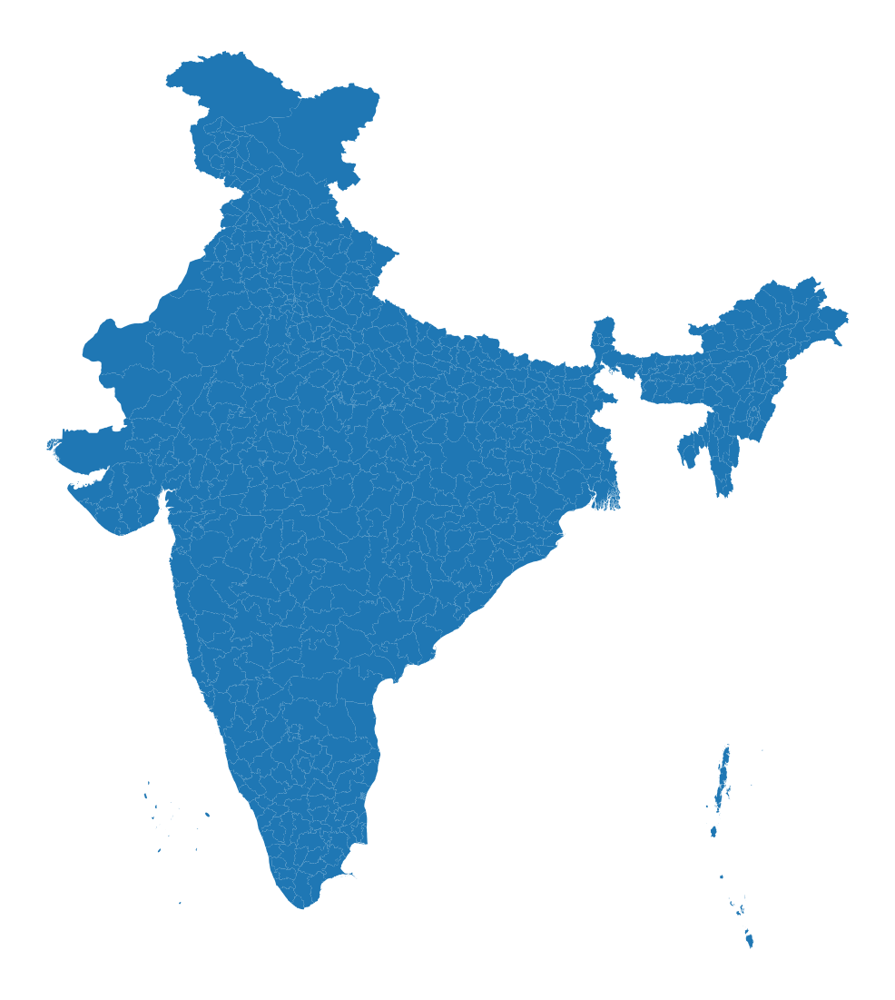

In [ ]:
plot = map_df.plot(figsize=(20, 20))
plot.axis('off')

In [ ]:
done = pd.read_csv('done.csv')
done

,Unnamed: 0,Code,Confirmed,Active,Recovered,Deceased,No_HH,TOT_P,P_LIT,TOT_WORK_P,Total number of households_1,Total number of households_2,Total number of households_3,Total number of households_4,Total number of households_5,Total number of households_6-8,Total number of households_9+,percentage_within_premises,percentage_alternative_public,percentage_alternative_open,Total_households,pop_above60,Total Households with None Workers,Total workers in households with one workers
0,0,1,5631,58,5479,94,113929,870354,439654,229064,911,4036,6396,10700,14886,42727,27121,0.508864,0.077910,0.413226,112761,49047,9307,58374
1,1,3,7565,73,7408,84,21909,133487,93770,75079,1630,1483,2302,4422,3804,5378,1758,0.903884,0.010396,0.085720,21435,11489,1697,6085
2,2,4,2103,4,2055,44,18338,140802,86236,51873,689,834,983,1652,2356,6832,4866,0.969086,0.004448,0.026466,18017,9343,1255,6370
3,3,5,2485,30,2431,24,90261,476835,261724,161393,1531,7435,10664,15825,18028,31443,3952,0.186615,0.020500,0.792885,89907,33381,7661,43710
4,4,6,3864,7,3802,55,130401,642415,364109,290912,2107,12777,18069,25803,26161,35702,3381,0.143371,0.013839,0.842790,129528,45048,9142,39185
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
597,597,636,1942,71,1862,9,7420,41816,36470,11802,185,402,821,1655,1083,1709,1342,0.978324,0.015284,0.006392,7403,5015,1239,2891
598,598,637,3849,24,3761,64,49705,200222,154916,68301,2894,5828,9084,15087,9435,6876,864,0.605696,0.032656,0.361648,49642,19327,5141,27633
599,599,638,0,0,0,0,9288,36842,25332,17125,960,1442,1954,2326,1499,1443,335,0.808816,0.008133,0.183051,9214,2648,951,4245
600,600,639,1,0,1,0,26199,105597,78683,38579,2124,2847,4593,7087,4587,4324,765,0.482546,0.009420,0.508034,26141,8998,1610,14891


In [ ]:
done = done.drop(['Unnamed: 0'], axis = 1)

In [ ]:
done

,Code,Confirmed,Active,Recovered,Deceased,No_HH,TOT_P,P_LIT,TOT_WORK_P,Total number of households_1,Total number of households_2,Total number of households_3,Total number of households_4,Total number of households_5,Total number of households_6-8,Total number of households_9+,percentage_within_premises,percentage_alternative_public,percentage_alternative_open,Total_households,pop_above60,Total Households with None Workers,Total workers in households with one workers
0,1,5631,58,5479,94,113929,870354,439654,229064,911,4036,6396,10700,14886,42727,27121,0.508864,0.077910,0.413226,112761,49047,9307,58374
1,3,7565,73,7408,84,21909,133487,93770,75079,1630,1483,2302,4422,3804,5378,1758,0.903884,0.010396,0.085720,21435,11489,1697,6085
2,4,2103,4,2055,44,18338,140802,86236,51873,689,834,983,1652,2356,6832,4866,0.969086,0.004448,0.026466,18017,9343,1255,6370
3,5,2485,30,2431,24,90261,476835,261724,161393,1531,7435,10664,15825,18028,31443,3952,0.186615,0.020500,0.792885,89907,33381,7661,43710
4,6,3864,7,3802,55,130401,642415,364109,290912,2107,12777,18069,25803,26161,35702,3381,0.143371,0.013839,0.842790,129528,45048,9142,39185
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
597,636,1942,71,1862,9,7420,41816,36470,11802,185,402,821,1655,1083,1709,1342,0.978324,0.015284,0.006392,7403,5015,1239,2891
598,637,3849,24,3761,64,49705,200222,154916,68301,2894,5828,9084,15087,9435,6876,864,0.605696,0.032656,0.361648,49642,19327,5141,27633
599,638,0,0,0,0,9288,36842,25332,17125,960,1442,1954,2326,1499,1443,335,0.808816,0.008133,0.183051,9214,2648,951,4245
600,639,1,0,1,0,26199,105597,78683,38579,2124,2847,4593,7087,4587,4324,765,0.482546,0.009420,0.508034,26141,8998,1610,14891


In [ ]:
final = pd.merge(left=done, right=map_df, left_on='Code', right_on='censuscode')

In [ ]:
final

,Code,Confirmed,Active,Recovered,Deceased,No_HH,TOT_P,P_LIT,TOT_WORK_P,Total number of households_1,Total number of households_2,Total number of households_3,Total number of households_4,Total number of households_5,Total number of households_6-8,Total number of households_9+,percentage_within_premises,percentage_alternative_public,percentage_alternative_open,Total_households,pop_above60,Total Households with None Workers,Total workers in households with one workers,censuscode,geometry
0,1,5631,58,5479,94,113929,870354,439654,229064,911,4036,6396,10700,14886,42727,27121,0.508864,0.077910,0.413226,112761,49047,9307,58374,1,"POLYGON ((74.60352 34.86906, 74.59993 34.86392..."
1,3,7565,73,7408,84,21909,133487,93770,75079,1630,1483,2302,4422,3804,5378,1758,0.903884,0.010396,0.085720,21435,11489,1697,6085,3,"POLYGON ((79.38467 35.99429, 79.38682 35.99047..."
2,4,2103,4,2055,44,18338,140802,86236,51873,689,834,983,1652,2356,6832,4866,0.969086,0.004448,0.026466,18017,9343,1255,6370,4,"POLYGON ((76.66040 34.38012, 76.67459 34.32414..."
3,5,2485,30,2431,24,90261,476835,261724,161393,1531,7435,10664,15825,18028,31443,3952,0.186615,0.020500,0.792885,89907,33381,7661,43710,5,"POLYGON ((74.32009 33.95562, 74.32773 33.94523..."
4,6,3864,7,3802,55,130401,642415,364109,290912,2107,12777,18069,25803,26161,35702,3381,0.143371,0.013839,0.842790,129528,45048,9142,39185,6,"POLYGON ((74.55452 33.47691, 74.55637 33.47598..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
597,636,1942,71,1862,9,7420,41816,36470,11802,185,402,821,1655,1083,1709,1342,0.978324,0.015284,0.006392,7403,5015,1239,2891,636,"MULTIPOLYGON (((75.54502 11.73396, 75.55523 11..."
598,637,3849,24,3761,64,49705,200222,154916,68301,2894,5828,9084,15087,9435,6876,864,0.605696,0.032656,0.361648,49642,19327,5141,27633,637,"POLYGON ((79.76528 10.99681, 79.76963 10.99519..."
599,638,0,0,0,0,9288,36842,25332,17125,960,1442,1954,2326,1499,1443,335,0.808816,0.008133,0.183051,9214,2648,951,4245,638,"MULTIPOLYGON (((93.84861 7.24051, 93.84870 7.2..."
600,639,1,0,1,0,26199,105597,78683,38579,2124,2847,4593,7087,4587,4324,765,0.482546,0.009420,0.508034,26141,8998,1610,14891,639,"MULTIPOLYGON (((92.89905 12.91512, 92.89905 12..."


In [ ]:
from geopandas import GeoDataFrame


In [ ]:
final = GeoDataFrame(final)

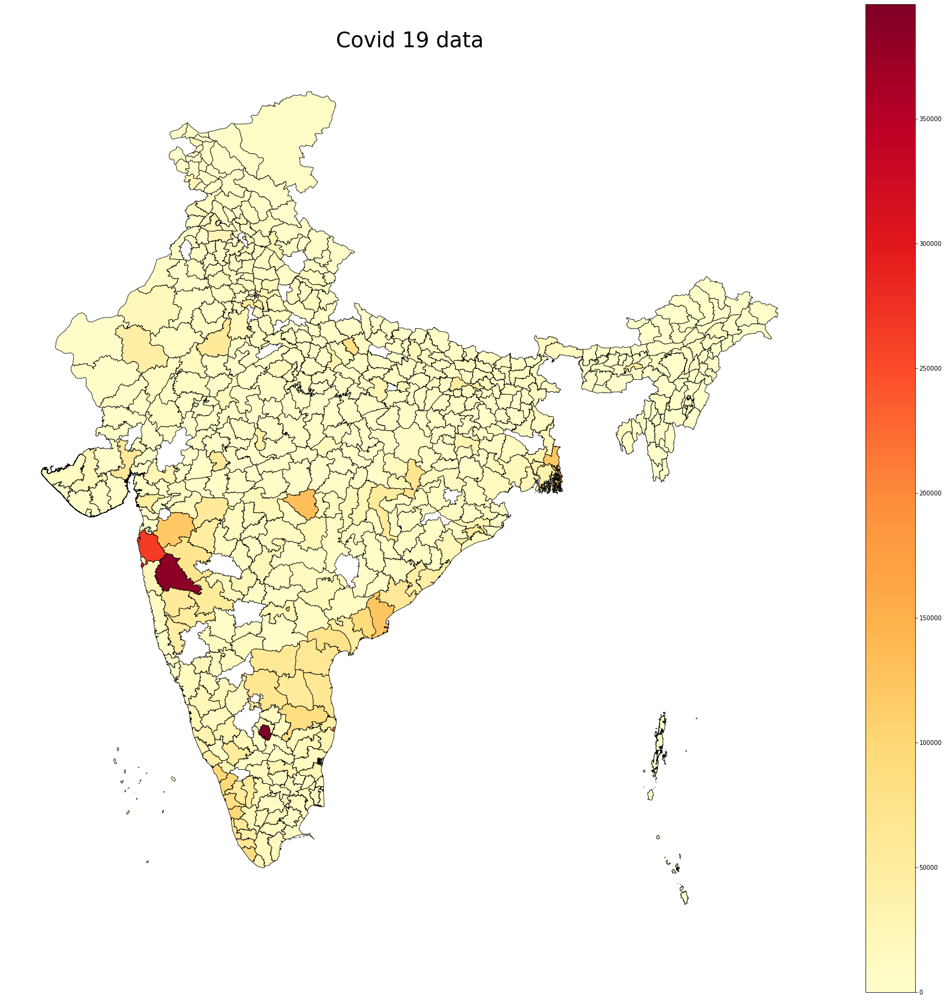

In [ ]:
fig, ax = plt.subplots(1, figsize=(30, 30))
ax.axis('off')
ax.set_facecolor('#FFFFFF')
ax.set_title("Covid 19 data", fontdict={'fontsize' : '35', 'fontweight' : '10'})
final.plot(column='Confirmed', cmap='YlOrRd', linewidth=0.8, ax=ax, edgecolor='0', legend=True, markersize=[39.739192, -104.990337])
fig.savefig('Confirmed.png')

In [ ]:
dataset = done.loc[:, ['Confirmed', 'Deceased', 'TOT_P', 'P_LIT', 'TOT_WORK_P', 'percentage_alternative_public']]

In [ ]:
from sklearn.cluster import KMeans

In [ ]:
kmeans = KMeans(n_clusters=50, max_iter=500, init='random')
y = kmeans.fit_predict(dataset)
y = pd.Series(y)

In [ ]:
final = pd.concat([final, y], axis = 1)

In [ ]:
final = GeoDataFrame(final)
final.columns


Index([                                        'Code',
                                          'Confirmed',
                                             'Active',
                                          'Recovered',
                                           'Deceased',
                                              'No_HH',
                                              'TOT_P',
                                              'P_LIT',
                                         'TOT_WORK_P',
                       'Total number of households_1',
                       'Total number of households_2',
                       'Total number of households_3',
                       'Total number of households_4',
                       'Total number of households_5',
                     'Total number of households_6-8',
                      'Total number of households_9+',
                         'percentage_within_premises',
                      'percentage_alternative_public',
          

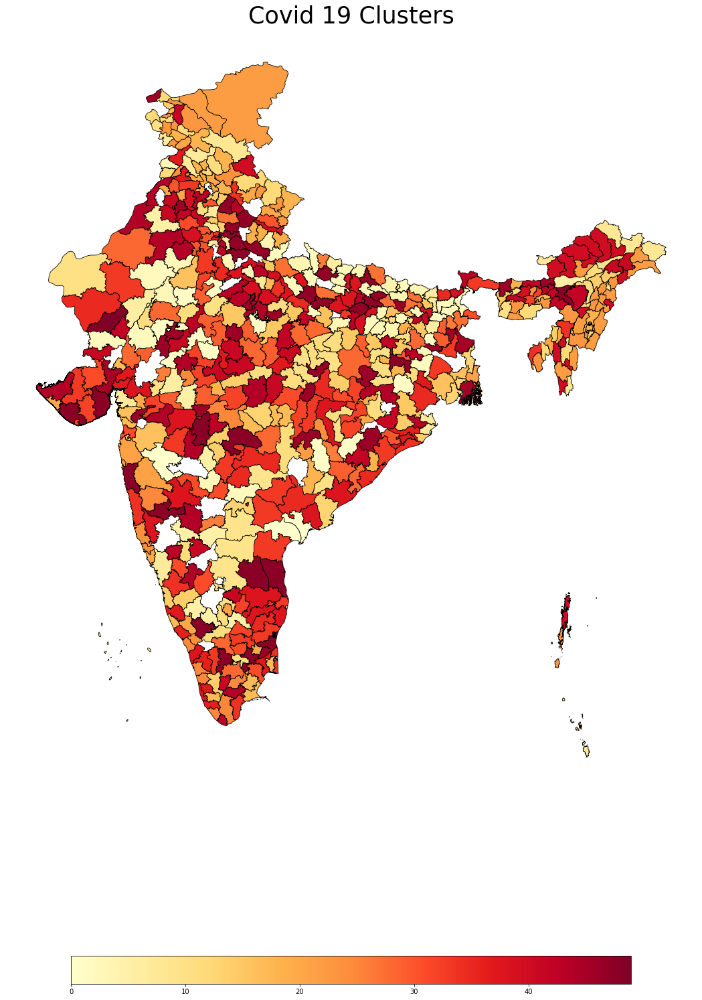

In [ ]:
fig, ax = plt.subplots(1, figsize=(30, 30))
ax.axis('off')
ax.set_facecolor('#FFFFFF')
ax.set_title("Covid 19 Clusters", fontdict={'fontsize' : '35', 'fontweight' : '10'})
final.plot(column=0, cmap='YlOrRd', linewidth=0.8, ax=ax, edgecolor='0', legend=True, legend_kwds={'shrink': 0.5, 'orientation': "horizontal"})
fig.savefig('Clusters.png')

In [ ]:
final.columns

Index([                                        'Code',
                                          'Confirmed',
                                             'Active',
                                          'Recovered',
                                           'Deceased',
                                              'No_HH',
                                              'TOT_P',
                                              'P_LIT',
                                         'TOT_WORK_P',
                       'Total number of households_1',
                       'Total number of households_2',
                       'Total number of households_3',
                       'Total number of households_4',
                       'Total number of households_5',
                     'Total number of households_6-8',
                      'Total number of households_9+',
                         'percentage_within_premises',
                      'percentage_alternative_public',
          

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).

/usr/local/lib/python3.6/dist-packages/ipykernel_launcher.py:2: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning

TypeError: ignored

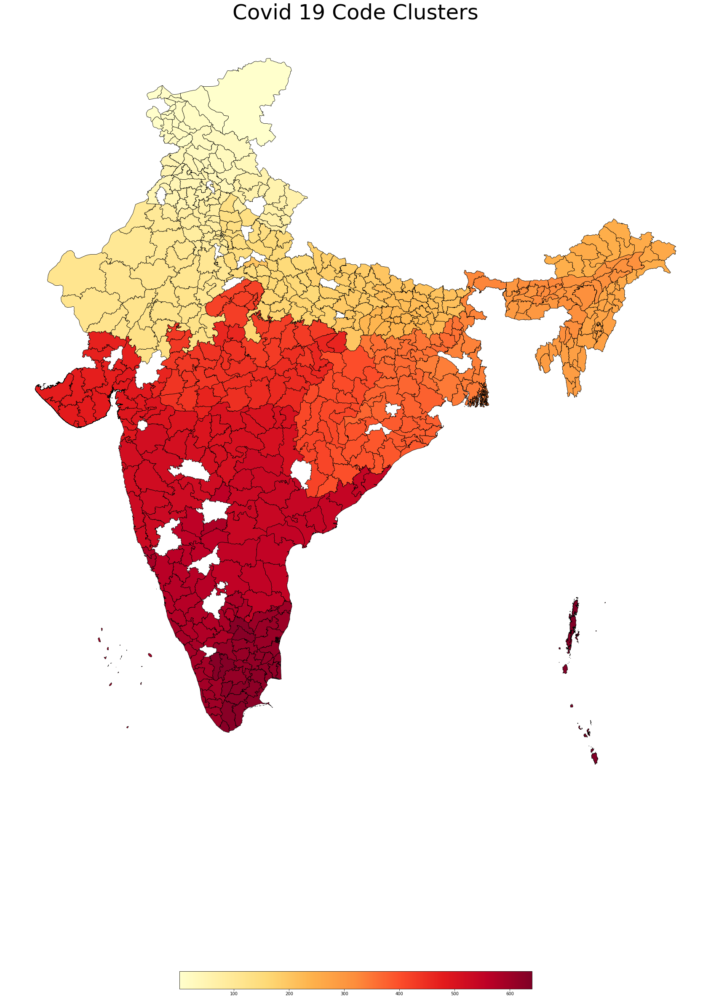

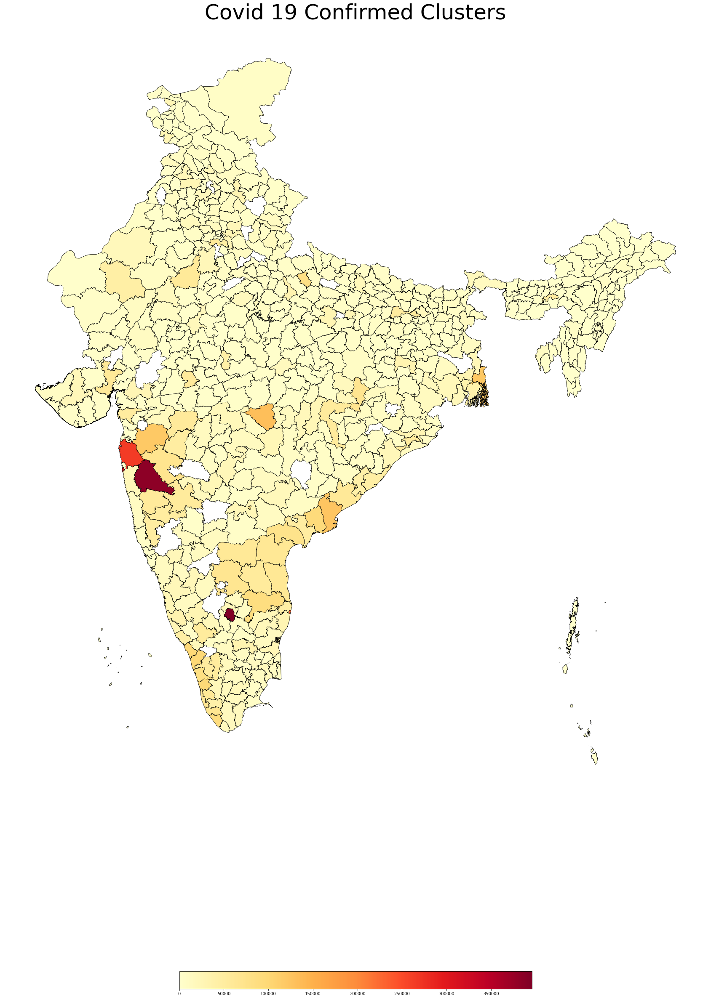

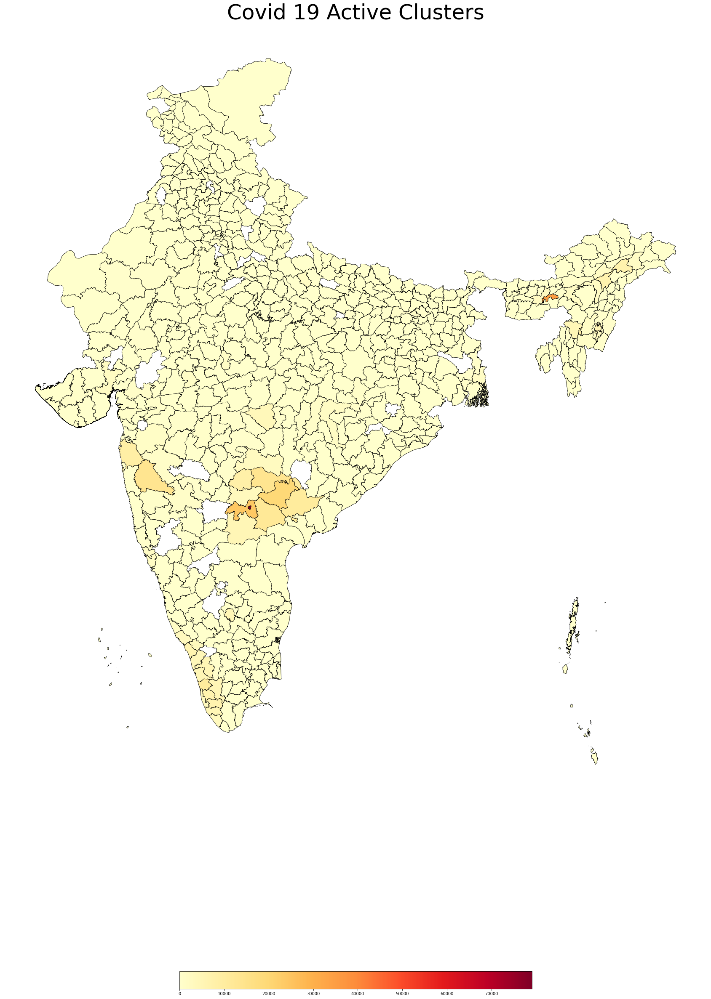

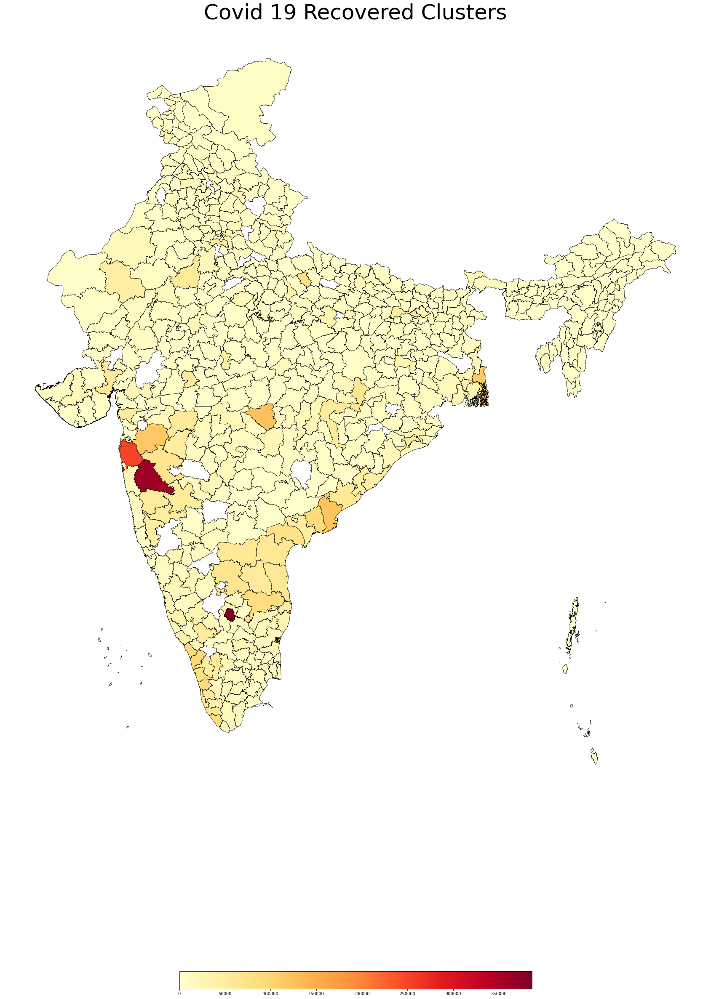

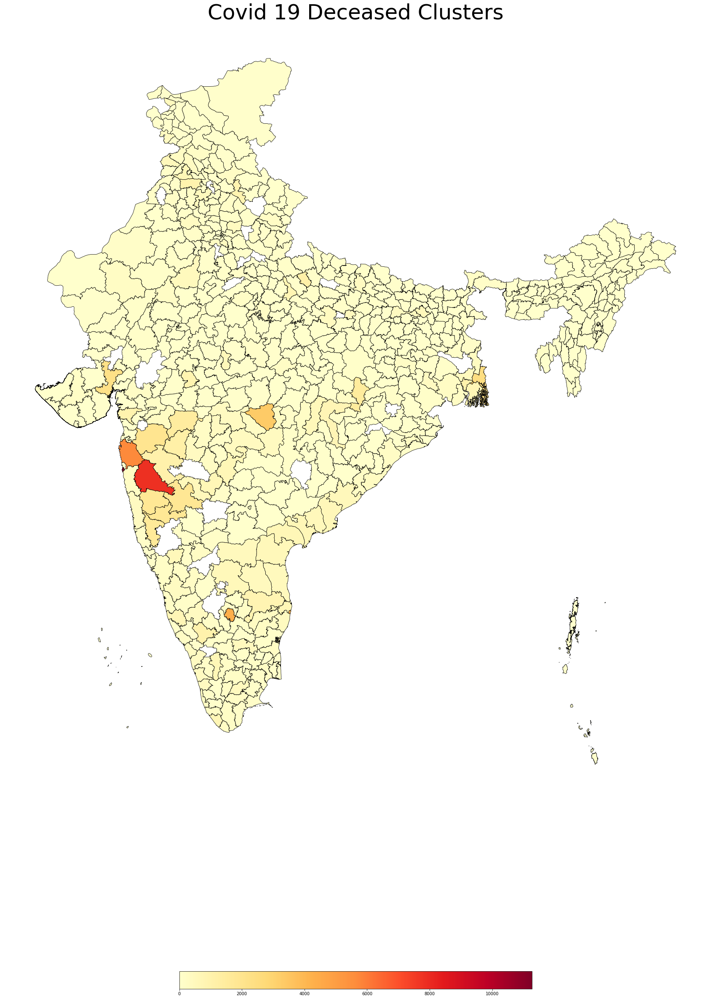

...

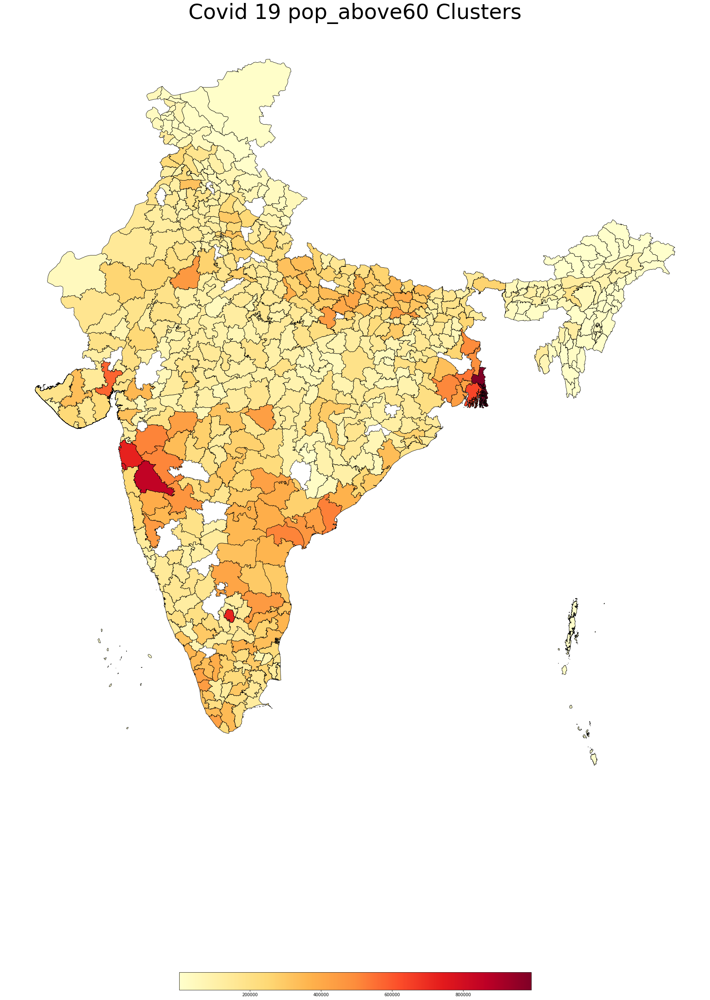

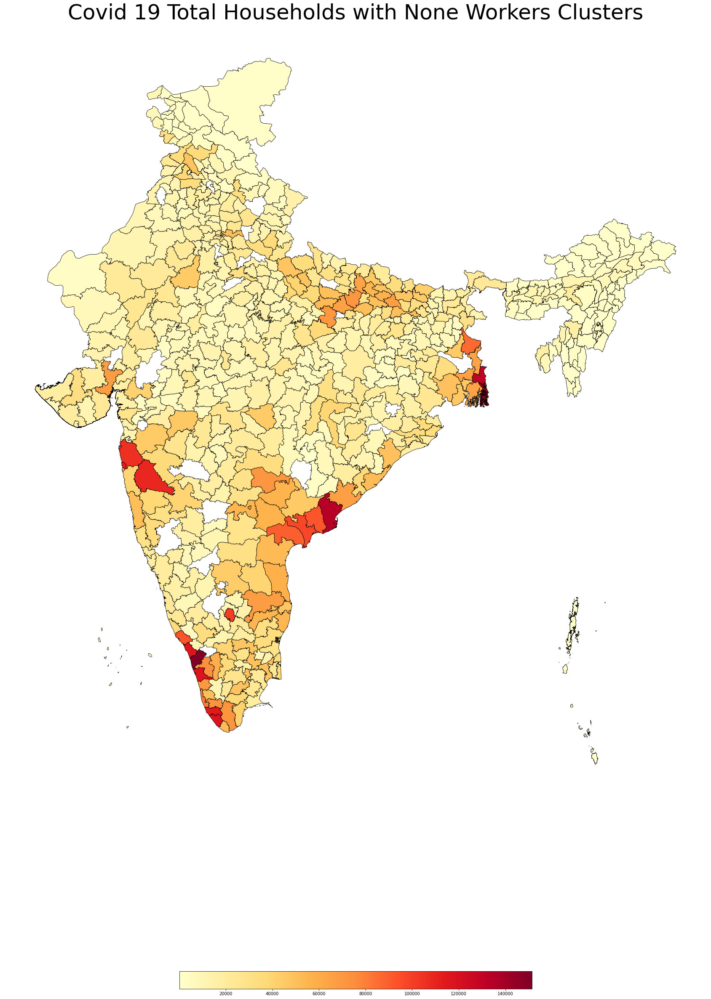

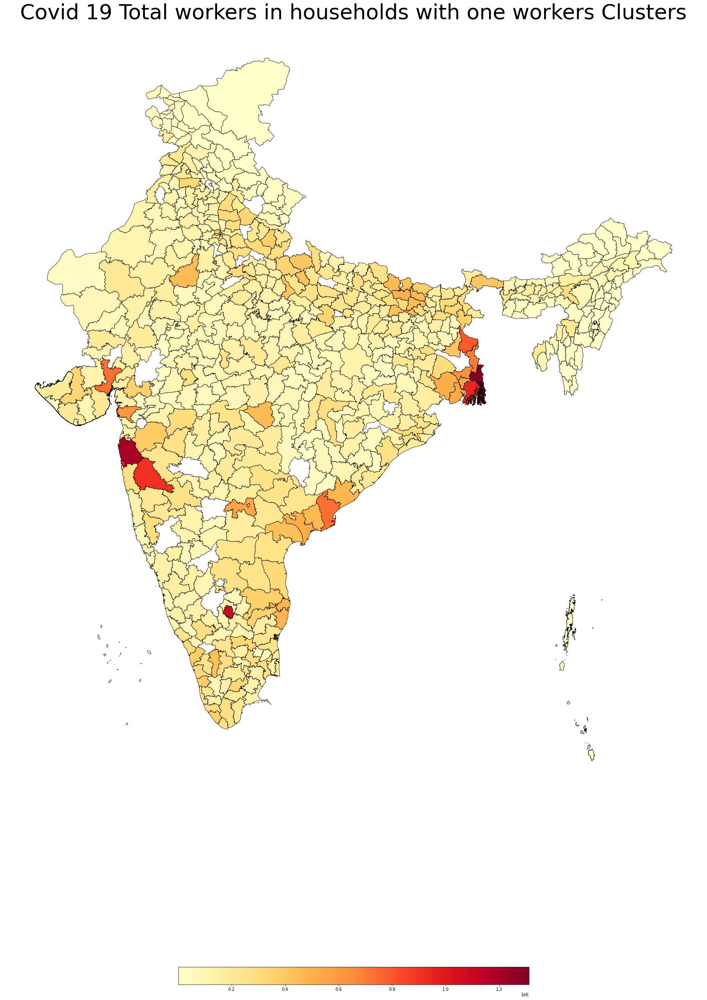

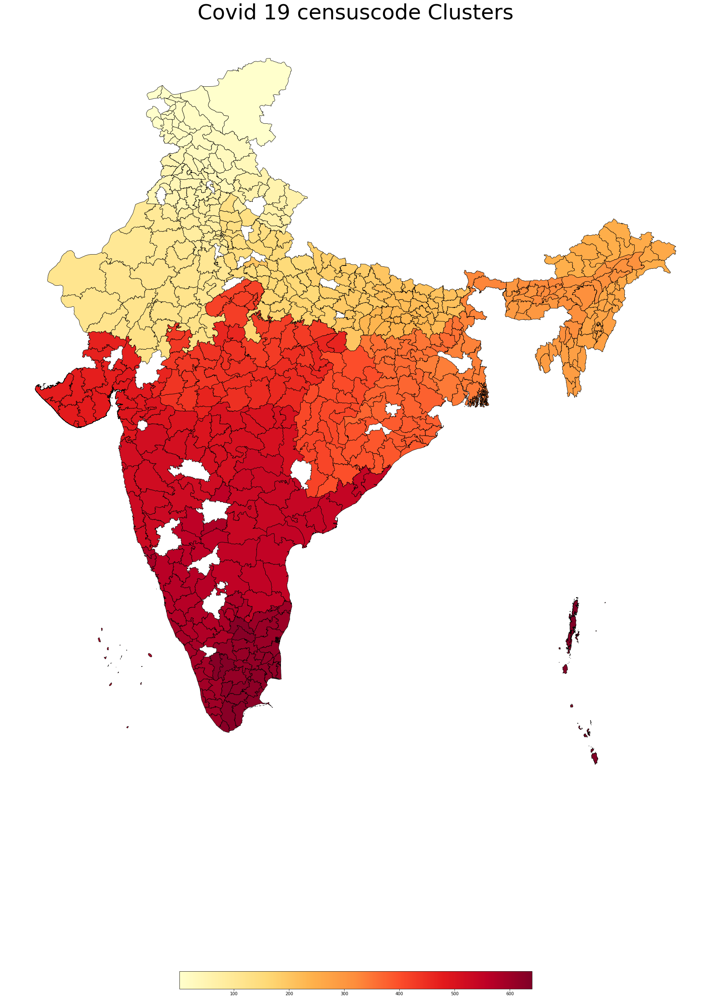

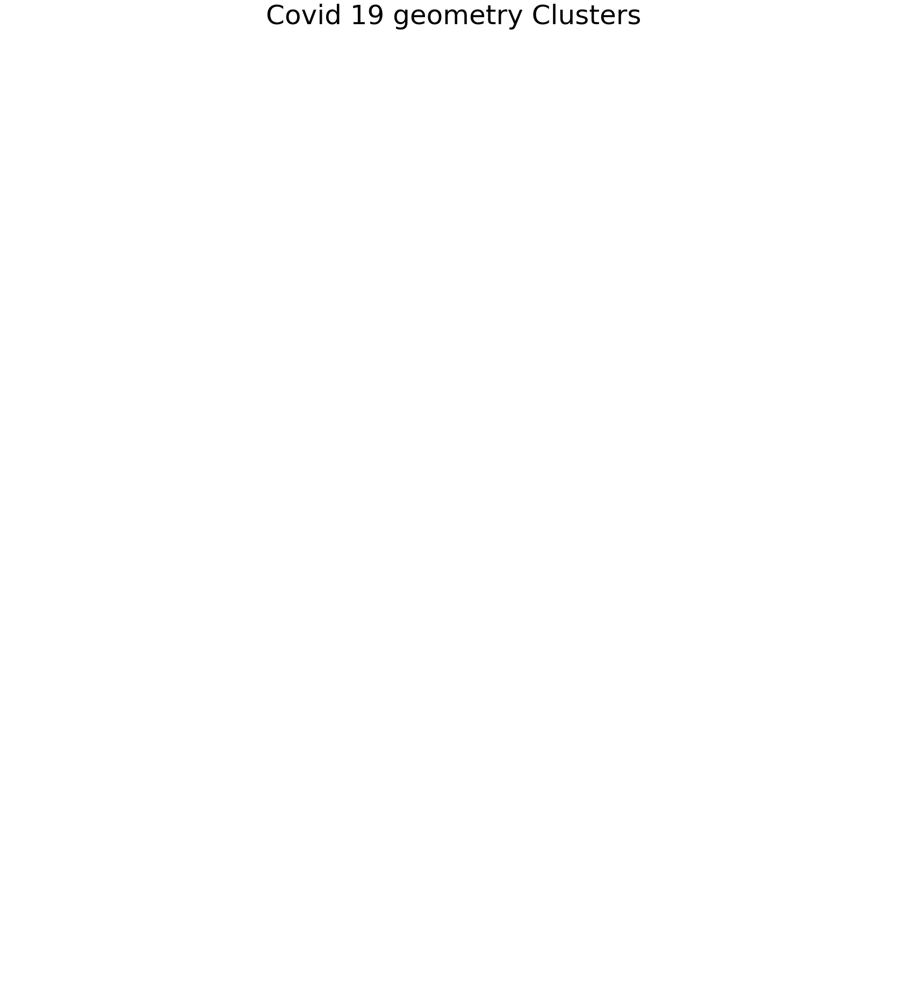

In [ ]:
for i in final.columns:
  fig, ax = plt.subplots(1, figsize=(30, 50))
  ax.axis('off')
  ax.set_facecolor('#FFFFFF')
  ax.set_title(f"Covid 19 {i} Clusters", fontdict={'fontsize' : '50', 'fontweight' : '10'})
  final.plot(column=i, cmap='YlOrRd', linewidth=0.8, ax=ax, edgecolor='0', legend=True, legend_kwds={'shrink': 0.5, 'orientation': "horizontal"})
  fig.savefig(f'graphs/{i}.png')

In [ ]:
from google.colab import files
files.download("/content/graphs.zip")

In [ ]:
!zip -r /content/graphs.zip /content/graphs
